In [20]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision.transforms import ToTensor
from torchvision.utils import save_image
from PIL import Image
import os
from glob import glob
import cv2
import numpy as np
import matplotlib.pyplot as plt
import torchvision.transforms as transforms

In [21]:
class Dataset(torch.utils.data.Dataset):
    
      def __init__(
          self,
          transform = None,
          classes = None,
          augmentation = None
          ):
        self.imgpath_list = sorted(glob('C:/Users/asus/Desktop/ML/archive (1)/dataset/semantic_drone_dataset/original_images/*.jpg'))

        self.labelpath_list = sorted(glob('C:/Users/asus/Desktop/ML/archive (1)/dataset/semantic_drone_dataset/label_images_semantic/*.png'))

      def __getitem__(self, i):
                
        imgpath = self.imgpath_list[i]
        img = cv2.imread(imgpath)
        img = cv2.resize(img, dsize = (256, 256))
        img = img / 255
        img = torch.from_numpy(img.astype(np.float32)).clone()
        img = img.permute(2, 0, 1)

        labelpath = self.labelpath_list[i]
        label = Image.open(labelpath)
        label = np.asarray(label)
        label = cv2.resize(label, dsize = (256, 256))
        label = torch.from_numpy(label.astype(np.float32)).clone()
        label = torch.nn.functional.one_hot(label.long(), num_classes = 24)
        label = label.to(torch.float32)
        label = label.permute(2, 0, 1)

        data = {"img": img, "label": label}
        return data

      def __len__(self):
            return len(self.imgpath_list)

In [22]:
dataset = Dataset()


In [23]:
len(dataset)

400

In [24]:
train, val, test = torch.utils.data.random_split(dataset=dataset, lengths=[320, 40, 40], generator=torch.Generator().manual_seed(42))


In [25]:
batch_size = 8

train_loader = torch.utils.data.DataLoader(train, batch_size, shuffle = True, drop_last = True)
val_loader = torch.utils.data.DataLoader(val, batch_size)
test_loader = torch.utils.data.DataLoader(test, batch_size)

In [26]:
import torch
import torch.nn as nn

class UNet(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(UNet, self).__init__()

        # Encoder
        self.encoder_conv1 = self.conv_block(in_channels, 64)
        self.encoder_pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.encoder_conv2 = self.conv_block(64, 128)
        self.encoder_pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.encoder_conv3 = self.conv_block(128, 256)
        self.encoder_pool3 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.encoder_conv4 = self.conv_block(256, 512)
        self.encoder_pool4 = nn.MaxPool2d(kernel_size=2, stride=2)

        # Bottleneck
        self.bottleneck_conv = self.conv_block(512, 1024)

        # Decoder
        self.decoder_upconv4 = nn.ConvTranspose2d(1024, 512, kernel_size=2, stride=2)
        self.decoder_conv4 = self.conv_block(1024, 512)
        self.decoder_upconv3 = nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)
        self.decoder_conv3 = self.conv_block(512, 256)
        self.decoder_upconv2 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.decoder_conv2 = self.conv_block(256, 128)
        self.decoder_upconv1 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.decoder_conv1 = self.conv_block(128, 64)

        # Output layer
        self.output_conv = nn.Conv2d(64, out_channels, kernel_size=1)

    def forward(self, x):
        # Encoder
        encoder1 = self.encoder_conv1(x)
        encoder2 = self.encoder_conv2(self.encoder_pool1(encoder1))
        encoder3 = self.encoder_conv3(self.encoder_pool2(encoder2))
        encoder4 = self.encoder_conv4(self.encoder_pool3(encoder3))

        # Bottleneck
        bottleneck = self.bottleneck_conv(self.encoder_pool4(encoder4))

        # Decoder
        decoder4 = self.decoder_upconv4(bottleneck)
        decoder4 = torch.cat((encoder4, decoder4), dim=1)
        decoder4 = self.decoder_conv4(decoder4)
        decoder3 = self.decoder_upconv3(decoder4)
        decoder3 = torch.cat((encoder3, decoder3), dim=1)
        decoder3 = self.decoder_conv3(decoder3)
        decoder2 = self.decoder_upconv2(decoder3)
        decoder2 = torch.cat((encoder2, decoder2), dim=1)
        decoder2 = self.decoder_conv2(decoder2)
        decoder1 = self.decoder_upconv1(decoder2)
        decoder1 = torch.cat((encoder1, decoder1), dim=1)
        decoder1 = self.decoder_conv1(decoder1)

        # Output layer
        output = self.output_conv(decoder1)

        return output

    def conv_block(self, in_channels, out_channels):
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.ReLU(inplace=True)
        )


In [27]:
import torch
import torch.nn as nn



# Create an instance of the UNet model
in_channels = 3  # Number of input channels (e.g., RGB image)
out_channels = 24  # Number of output channels (e.g., number of classes)
unet_model = UNet(in_channels, out_channels)


# Print the model architecture
print(unet_model)

# Move the model to the device (e.g., GPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
unet_model = unet_model.to(device)

# Define the loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(unet_model.parameters(), lr=0.001)




UNet(
  (encoder_conv1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
  )
  (encoder_pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (encoder_conv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
  )
  (encoder_pool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (encoder_conv3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
  )
  (encoder_pool3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, 

In [28]:
num_epochs = 20
best_loss = float('inf')
best_model_state_dict = None

for epoch in range(num_epochs):
    unet_model.train()
    total_loss = 0.0

    for i, sample in enumerate(train_loader):
        inputs = sample['img'].to(device)
        labels = sample['label'].to(device)
        optimizer.zero_grad()
        outputs = unet_model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

        if (i + 1) % 10 == 0:
            print(f"Epoch [{epoch+1}/{num_epochs}], Batch [{i+1}/{len(train_loader)}], Loss: {loss.item():.4f}")

    average_loss = total_loss / len(train_loader)
    print(f"Epoch [{epoch+1}/{num_epochs}], Average Loss: {average_loss:.4f}")

    # Val
    unet_model.eval()
    total_val_loss = 0.0

    for i, val_sample in enumerate(val_loader):
        val_inputs = val_sample['img'].to(device)
        val_labels = val_sample['label'].to(device)
        val_outputs = unet_model(val_inputs)
        val_loss = criterion(val_outputs, val_labels)
        total_val_loss += val_loss.item()

    average_val_loss = total_val_loss / len(val_loader)
    print(f"Epoch [{epoch+1}/{num_epochs}], Val Loss: {average_val_loss:.4f}")

    # Check if the current model has the best val loss
    if average_val_loss < best_loss:
        best_loss = average_val_loss
        best_model_state_dict = unet_model.state_dict()

# After training, you can use the best model state dict to load the best model
if best_model_state_dict is not None:
    unet_model.load_state_dict(best_model_state_dict)


Epoch [1/20], Batch [10/40], Loss: 3.0880
Epoch [1/20], Batch [20/40], Loss: 3.1385
Epoch [1/20], Batch [30/40], Loss: 3.0065
Epoch [1/20], Batch [40/40], Loss: 2.9891
Epoch [1/20], Average Loss: 4.1308
Epoch [1/20], Val Loss: 2.9962
Epoch [2/20], Batch [10/40], Loss: 2.6857
Epoch [2/20], Batch [20/40], Loss: 2.3428
Epoch [2/20], Batch [30/40], Loss: 2.0463
Epoch [2/20], Batch [40/40], Loss: 2.2359
Epoch [2/20], Average Loss: 2.4777
Epoch [2/20], Val Loss: 2.1007
Epoch [3/20], Batch [10/40], Loss: 2.1799
Epoch [3/20], Batch [20/40], Loss: 1.8913
Epoch [3/20], Batch [30/40], Loss: 2.0913
Epoch [3/20], Batch [40/40], Loss: 2.0040
Epoch [3/20], Average Loss: 2.0722
Epoch [3/20], Val Loss: 2.0068
Epoch [4/20], Batch [10/40], Loss: 2.2464
Epoch [4/20], Batch [20/40], Loss: 1.8623
Epoch [4/20], Batch [30/40], Loss: 1.8600
Epoch [4/20], Batch [40/40], Loss: 1.6405
Epoch [4/20], Average Loss: 1.9816
Epoch [4/20], Val Loss: 1.9437
Epoch [5/20], Batch [10/40], Loss: 1.8653
Epoch [5/20], Batch [2

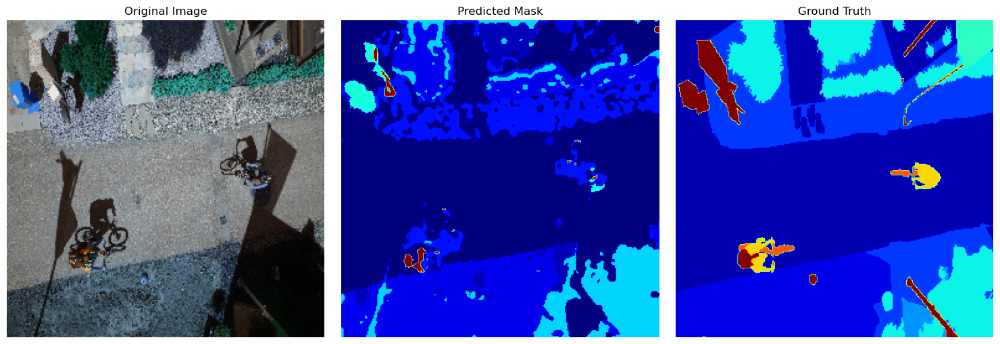

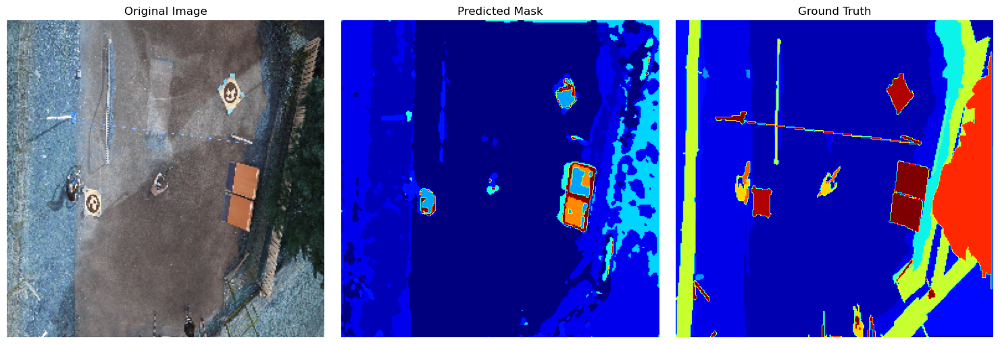

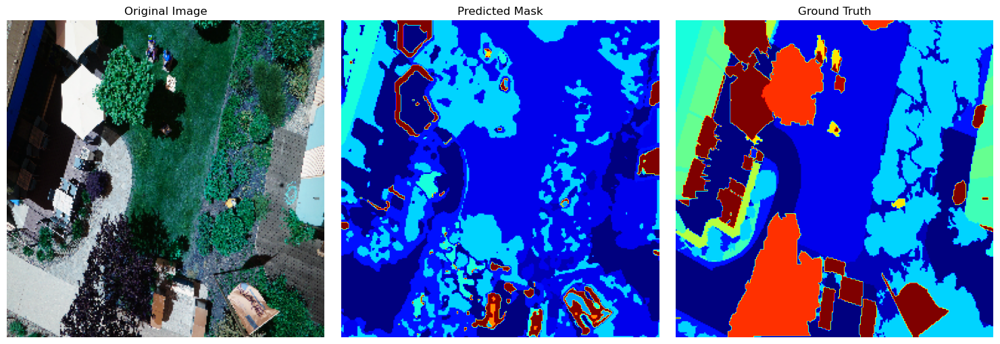

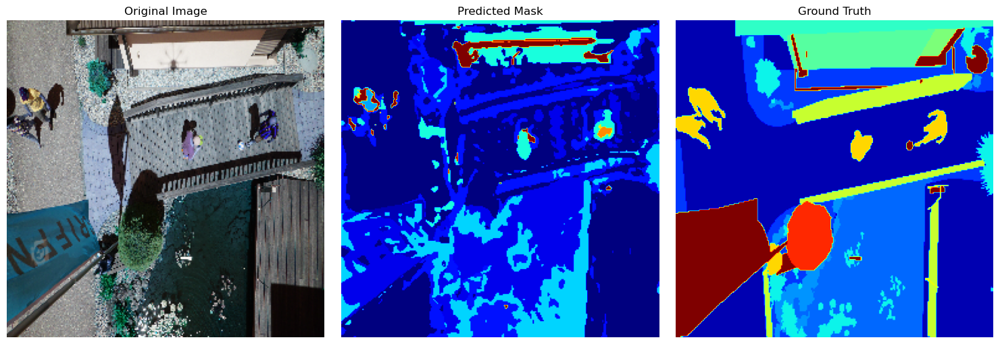

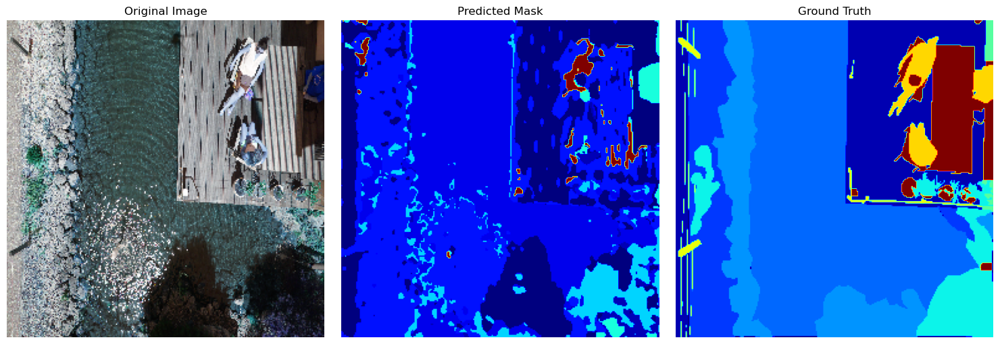

...

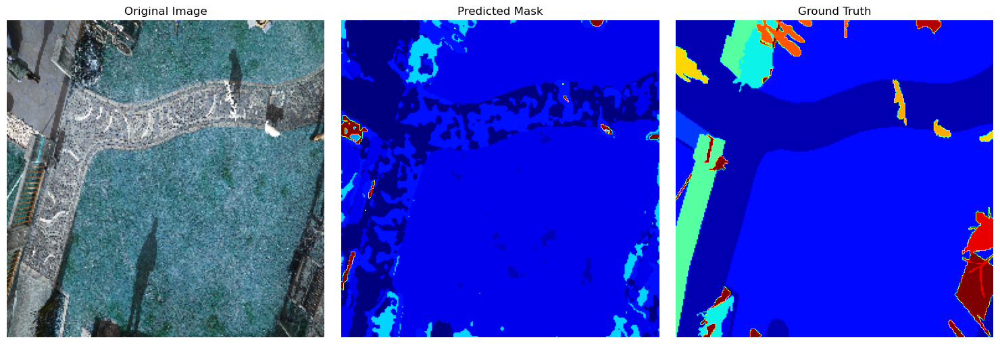

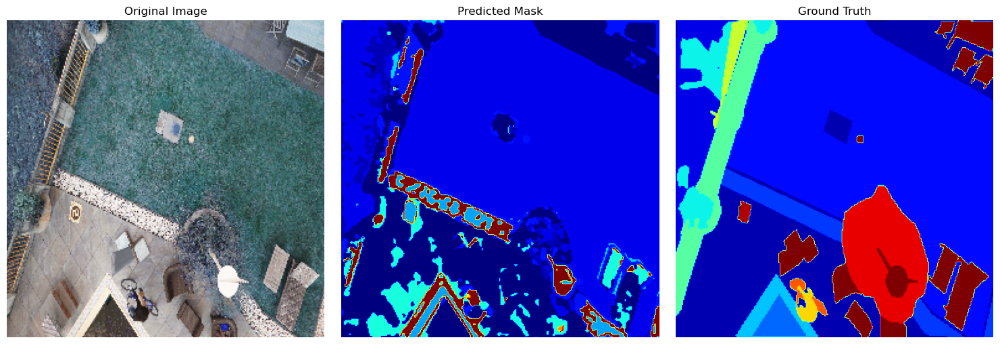

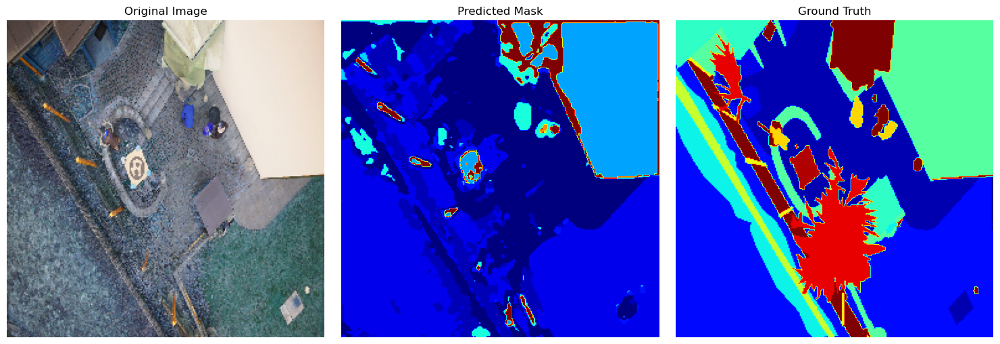

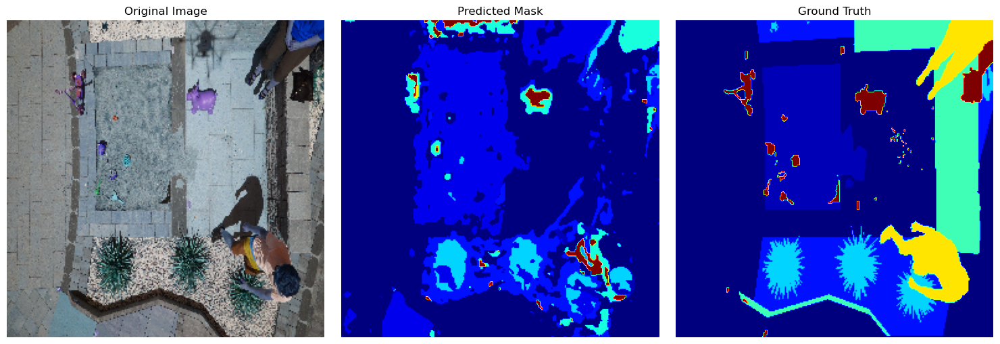

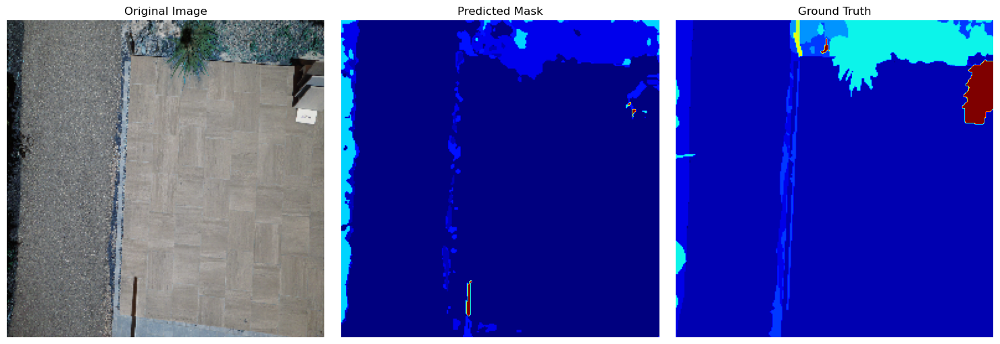

In [29]:
import matplotlib.pyplot as plt
import numpy as np

unet_model.eval()
with torch.no_grad():
    for i, sample in enumerate(test_loader):
        inputs = sample['img'].to(device)
        labels = sample['label'].to(device)

        # Forward pass
        outputs = unet_model(inputs)

        for j in range(inputs.shape[0]):  # Iterate over the batch dimension
            input_image = inputs[j].cpu().numpy()
            output_image = outputs[j].argmax(dim=0).cpu().numpy()  # Convert the predicted output to class indices
            label_image = labels[j].argmax(dim=0).cpu().numpy()  # Convert the ground truth labels to class indices

            input_image = np.transpose(input_image, (1, 2, 0))

            fig, axes = plt.subplots(1, 3, figsize=(15, 5))

            axes[0].imshow(input_image)
            axes[0].set_title('Original Image')
            axes[0].axis('off')

            axes[1].imshow(output_image, cmap='jet')
            axes[1].set_title('Predicted Mask')
            axes[1].axis('off')

            axes[2].imshow(label_image, cmap='jet')
            axes[2].set_title('Ground Truth')
            axes[2].axis('off')

            plt.tight_layout()
            plt.show()


In [33]:
def calculate_iou(output_image, input_image):
    intersection = np.logical_and(output_image, input_image)
    union = np.logical_or(output_image, input_image)
    iou_score = np.sum(intersection) / np.sum(union)
    print(iou_score)

def calculate_pixel_accuracy(output_image, input_image):
    correct_pixels = np.sum(output_image == input_image)
    total_pixels = output_image.size
    pixel_accuracy = correct_pixels / total_pixels
    print(pixel_accuracy)

def calculate_miou(output_images, input_images):
    miou_scores = []
    for i in range(len(output_images)):
        iou_score = calculate_iou(output_images[i], input_images[i])
        if iou_score is not None:  # Check for None values
            miou_scores.append(iou_score)
    if miou_scores:  # Check if miou_scores is not empty
        miou = np.mean(miou_scores)
        print(miou)
    else:
        print("No valid IoU scores found.")



In [35]:
calculate_iou(output_image, label_image)
print("*"*50)
calculate_pixel_accuracy(output_image, label_image)
print("*"*50)
calculate_miou(output_image, label_image)


0.9997100830078125
**************************************************
0.8454132080078125
**************************************************
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.99609375
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.99609375
1.0
1.0
1.0
1.0
1.0
1.0
0.99609375
1.0
1.0
1.0
1.0
1.0
1.0
0.99609375
0.99609375
1.0
0.99609375
1.0
0.99609375
1.0
0.984375
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.99609375
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.99609375
0.99609375
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.99609375
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
0.99609375
0.99609375
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
1.0
